<a href="https://colab.research.google.com/github/ArijZouaoui/Tictactrip-DataExo/blob/main/Tictactrip_DataExo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install arcgis

In [3]:
import pandas as pd
import geopy.distance
from collections import defaultdict

from datetime import datetime
import time

import seaborn as sns
from matplotlib import pyplot as plt
import folium

import glob
from google.colab import drive

from arcgis.gis import GIS
import arcgis.network as network
from getpass import getpass

password = getpass('Enter password')

Enter password··········


In [6]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [7]:
path = '/content/gdrive/MyDrive/TicTacTrip_Data_Guy'

all_files = glob.glob(path + "/*.csv")
df_dict = {}

for filename in all_files:
    df_name = filename[44:-4]
    print(df_name)
    df_dict[df_name] = pd.read_csv(filename)

ticket_data
stations
providers
cities


In [8]:
df_cities = df_dict['cities']
df_cities.head()

,id,local_name,unique_name,latitude,longitude,population
0,5159,"Padua, Veneto, Italia",padua,45.406435,11.876761,209678.0
1,76,"Barcelona, Cataluña, España",barcelona,41.385064,2.173404,1611822.0
2,81,"Basel, Basel-Stadt, Schweiz",basel,47.593437,7.619812,NaN
3,259,"Erlangen, Bayern, Deutschland",erlangen,49.589674,11.011961,105412.0
4,11979,"Balș, Olt, România",balș,44.353354,24.095672,NaN


In [9]:
df_cities.isna().sum()

id                0
local_name        0
unique_name       1
latitude          0
longitude         0
population     7671
dtype: int64

In [10]:
df_stations = df_dict['stations']
df_stations.isna().sum()

id             0
unique_name    0
latitude       0
longitude      0
dtype: int64

In [11]:
df_ticket_data = df_dict['ticket_data']
df_ticket_data.isna().sum()

id                     0
company                0
o_station          41441
d_station          41441
departure_ts           0
arrival_ts             0
price_in_cents         0
search_ts              0
middle_stations    41441
other_companies    41441
o_city                 0
d_city                 0
dtype: int64

In [12]:
df_providers = df_dict['providers']
df_providers.isna().sum()

id                       0
company_id               0
provider_id             14
name                     0
fullname                 0
has_wifi                 3
has_plug                 3
has_adjustable_seats     3
has_bicycle              3
transport_type           0
dtype: int64

# I. Travel Duration Analysis

In [13]:
def calcul_duree(d1, d2):
  fmt = '%Y-%m-%d %H:%M:%S'

  #eleminate +00 part
  d1 = d1[:-3]
  d2 = d2[:-3]

  d1 = datetime.strptime(d1, fmt)
  d2 = datetime.strptime(d2, fmt)

  # Convert to Unix timestamp
  d1_ts = time.mktime(d1.timetuple())
  d2_ts = time.mktime(d2.timetuple())

  # They are now in seconds, subtract and then divide by 60 to get minutes.
  return (int(d2_ts-d1_ts) / 60)



In [14]:
df_ticket_data['duree'] = df_ticket_data.apply(lambda x: calcul_duree(x.departure_ts, x.arrival_ts), axis=1)

In [15]:
#This function returns the min/mean/max duration and price of each trajectory

def ticket_duration_analysis(df):

  df_g = df.groupby(['o_city','d_city'])

  duree_moyenne = df_g['duree'].mean().to_frame(name = 'mean_duration').reset_index()
  duree_max = df_g['duree'].max().to_frame(name = 'max_duration').reset_index()
  duree_min = df_g['duree'].min().to_frame(name = 'min_duration').reset_index()

  mean_price = df_g['price_in_cents'].mean().to_frame(name = 'mean_price').reset_index()
  max_price = df_g['price_in_cents'].max().to_frame(name = 'max_price').reset_index()
  min_price = df_g['price_in_cents'].min().to_frame(name = 'min_price').reset_index()

  df = pd.concat ([duree_min, duree_moyenne, duree_max, min_price, mean_price, max_price], axis=1).T.drop_duplicates().T
  return df

In [16]:
analyse_trajet = ticket_duration_analysis(df_ticket_data)
analyse_trajet.head()

,o_city,d_city,min_duration,mean_duration,max_duration,min_price,mean_price,max_price
0,5.0,23.0,533.0,618.800000,954.0,18600.0,20320.000000,22000.0
1,6.0,227.0,744.0,822.500000,901.0,9860.0,11755.000000,13650.0
2,6.0,504.0,336.0,497.400000,740.0,2000.0,4042.666667,8920.0
3,6.0,628.0,580.0,730.000000,870.0,2600.0,2797.500000,3190.0
4,6.0,845.0,60.0,79.910448,251.0,700.0,864.626866,2420.0


# II. Travel Distance Analysis

In [17]:
# To calculate the distance we start by getting the latitude/longitude coordinates of the origin 
#and destination locations
df_analyse_distance = df_ticket_data.merge(df_cities[['id', 'latitude', 'longitude']].rename(columns={'longitude' : 'o_lon', 'latitude': 'o_lat'}), left_on='o_city', right_on='id')
df_analyse_distance = df_analyse_distance.merge(df_cities[['id', 'latitude', 'longitude']].rename(columns={'longitude' : 'd_lon', 'latitude': 'd_lat'}), left_on='d_city', right_on='id')

df_analyse_distance.head()

,id_x,company,o_station,d_station,departure_ts,arrival_ts,price_in_cents,search_ts,middle_stations,other_companies,o_city,d_city,duree,id_y,o_lat,o_lon,id,d_lat,d_lon
0,6795025,8385,NaN,NaN,2017-10-13 14:00:00+00,2017-10-13 20:10:00+00,4550,2017-10-01 00:13:31.327+00,NaN,NaN,611,542,370.0,611,47.907018,1.90627,542,43.604452,3.918318
1,6795026,9,63.0,1044.0,2017-10-13 13:05:00+00,2017-10-14 06:55:00+00,1450,2017-10-01 00:13:35.773+00,"{149,418}",{13},611,542,1070.0,611,47.907018,1.90627,542,43.604452,3.918318
2,6795027,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 21:24:00+00,7400,2017-10-01 00:13:40.212+00,"{798,798,6794,6246}","{8377,8376}",611,542,1917.0,611,47.907018,1.90627,542,43.604452,3.918318
3,6795028,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 11:02:00+00,13500,2017-10-01 00:13:40.213+00,"{798,798,6794,6246}","{8377,8376}",611,542,1295.0,611,47.907018,1.90627,542,43.604452,3.918318
4,6795029,8381,5905.0,6495.0,2017-10-13 21:46:00+00,2017-10-14 19:32:00+00,7710,2017-10-01 00:13:40.213+00,"{5983,5983}",{8380},611,542,1306.0,611,47.907018,1.90627,542,43.604452,3.918318


In [18]:
df_analyse_distance.drop(columns=['id_y', 'id'], inplace=True)
df_analyse_distance.rename({'id_x' : 'id'}, axis=1, inplace=True)
df_analyse_distance.head()


,id,company,o_station,d_station,departure_ts,arrival_ts,price_in_cents,search_ts,middle_stations,other_companies,o_city,d_city,duree,o_lat,o_lon,d_lat,d_lon
0,6795025,8385,NaN,NaN,2017-10-13 14:00:00+00,2017-10-13 20:10:00+00,4550,2017-10-01 00:13:31.327+00,NaN,NaN,611,542,370.0,47.907018,1.90627,43.604452,3.918318
1,6795026,9,63.0,1044.0,2017-10-13 13:05:00+00,2017-10-14 06:55:00+00,1450,2017-10-01 00:13:35.773+00,"{149,418}",{13},611,542,1070.0,47.907018,1.90627,43.604452,3.918318
2,6795027,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 21:24:00+00,7400,2017-10-01 00:13:40.212+00,"{798,798,6794,6246}","{8377,8376}",611,542,1917.0,47.907018,1.90627,43.604452,3.918318
3,6795028,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 11:02:00+00,13500,2017-10-01 00:13:40.213+00,"{798,798,6794,6246}","{8377,8376}",611,542,1295.0,47.907018,1.90627,43.604452,3.918318
4,6795029,8381,5905.0,6495.0,2017-10-13 21:46:00+00,2017-10-14 19:32:00+00,7710,2017-10-01 00:13:40.213+00,"{5983,5983}",{8380},611,542,1306.0,47.907018,1.90627,43.604452,3.918318


## 1. Vicenty Distance


In [19]:
# we will use the Vicenty distance to calculate the geographic distance between two locations (it doesn't take routes
#in consideration)

def calculate_distance(lat_a, lon_a, lat_b, lon_b):
  return(geopy.distance.vincenty((lat_a, lon_a), (lat_b, lon_b)).km)

In [20]:
df_analyse_distance['vicenty_distance'] = df_analyse_distance.apply(lambda x: calculate_distance(x.o_lat, x.o_lon, x.d_lat, x.d_lon), axis=1)
df_analyse_distance.head()

,id,company,o_station,d_station,departure_ts,arrival_ts,price_in_cents,search_ts,middle_stations,other_companies,o_city,d_city,duree,o_lat,o_lon,d_lat,d_lon,vicenty_distance
0,6795025,8385,NaN,NaN,2017-10-13 14:00:00+00,2017-10-13 20:10:00+00,4550,2017-10-01 00:13:31.327+00,NaN,NaN,611,542,370.0,47.907018,1.90627,43.604452,3.918318,503.136831
1,6795026,9,63.0,1044.0,2017-10-13 13:05:00+00,2017-10-14 06:55:00+00,1450,2017-10-01 00:13:35.773+00,"{149,418}",{13},611,542,1070.0,47.907018,1.90627,43.604452,3.918318,503.136831
2,6795027,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 21:24:00+00,7400,2017-10-01 00:13:40.212+00,"{798,798,6794,6246}","{8377,8376}",611,542,1917.0,47.907018,1.90627,43.604452,3.918318,503.136831
3,6795028,8377,5905.0,6495.0,2017-10-13 13:27:00+00,2017-10-14 11:02:00+00,13500,2017-10-01 00:13:40.213+00,"{798,798,6794,6246}","{8377,8376}",611,542,1295.0,47.907018,1.90627,43.604452,3.918318,503.136831
4,6795029,8381,5905.0,6495.0,2017-10-13 21:46:00+00,2017-10-14 19:32:00+00,7710,2017-10-01 00:13:40.213+00,"{5983,5983}",{8380},611,542,1306.0,47.907018,1.90627,43.604452,3.918318,503.136831


In [21]:
df_analyse_distance['middle_stations'].isna().sum()

41441

In [22]:
# We will replace the NaN values in middle_stations with zero to perform further distance calculations
df_analyse_distance['middle_stations'] = df_analyse_distance['middle_stations'].fillna(0)

In [23]:
# This function allows us to get the longitude and latitude coordinates of all the middle stations of a specific 
#trajectory as two arrays

def get_lons_lats(middle_stations, df_stations):
  lons = []
  lats = []
  
  
  if (middle_stations != 0):
      stations_ids = list(eval(middle_stations))

      lons = []
      lats = []

      for item in stations_ids:
        longitude = df_stations[df_stations.id == item].longitude.values[0]
        latitude = df_stations[df_stations.id == item].latitude.values[0]
        lons.append(longitude)
        lats.append(latitude)    

  
  return(lons, lats)


In [24]:
#We will apply the get_lons_lats funtion on our dataframe 
df_analyse_distance['midd_stations_longitudes'], df_analyse_distance['midd_stations_latitudes'] = zip(*df_analyse_distance.apply(lambda x: get_lons_lats(x.middle_stations, df_stations), axis=1))

In [25]:
#The bellow function calculates the sum of distances between all the sucessive stations. 
#In case there is no middle stations, it returns the distance between the origin and destination locations
#that we already have in the vicenty_distance column

def calculate_distance_middstations(o_lat, o_lon, d_lat, d_lon, midd_stations_lon, midd_stations_lat, vicenty_distance):
  
  distance=0

  if (midd_stations_lon) != 0 :    
    # add origin and destination locations (longitude and latitude)
    midd_stations_lon = [o_lon] + midd_stations_lon + [d_lon]
    midd_stations_lat = [o_lat] + midd_stations_lat + [d_lat]


    #iterate through both lists to calculate the sum of distances between stations
    for i in range(len(midd_stations_lat)-1):
      distance += calculate_distance(midd_stations_lat[i], midd_stations_lon[i], midd_stations_lat[i+1], midd_stations_lon[i+1])

    return (distance)

  else:
    return(vicenty_distance)


In [26]:
df_analyse_distance['distance_with_stations'] = df_analyse_distance.apply(lambda x: calculate_distance_middstations(x.o_lat, x.o_lon, x.d_lat, x.d_lon, x.midd_stations_longitudes, x.midd_stations_latitudes, x.vicenty_distance), axis=1)

df_ticket_distance = df_analyse_distance[['id', 'o_city', 'd_city', 'company', 'duree', 'vicenty_distance', 'middle_stations', 'distance_with_stations', 'price_in_cents' ]]
df_ticket_distance.head()

,id,o_city,d_city,company,duree,vicenty_distance,middle_stations,distance_with_stations,price_in_cents
0,6795025,611,542,8385,370.0,503.136831,0,503.136831,4550
1,6795026,611,542,9,1070.0,503.136831,"{149,418}",504.259490,1450
2,6795027,611,542,8377,1917.0,503.136831,"{798,798,6794,6246}",755.866163,7400
3,6795028,611,542,8377,1295.0,503.136831,"{798,798,6794,6246}",755.866163,13500
4,6795029,611,542,8381,1306.0,503.136831,"{5983,5983}",630.761929,7710


##2. GIS - Distance considering routes

In [27]:
my_gis = GIS('https://www.arcgis.com', 'ArijZouaoui', password)
route_service_url = my_gis.properties.helperServices.route.url


def calcul_distance(lon_a, lat_a, lon_b, lat_b):
  stops = '\'\'\'' + str(lon_a)+','+str(lat_a)+'; '+str(lon_b)+','+str(lat_b)+'\'\'\''
  route_layer = network.RouteLayer(route_service_url, gis=my_gis)
  result = route_layer.solve(stops=stops, 
                           directions_language='en-US', return_routes=True,
                           return_stops=True, return_directions=False,
                           return_barriers=False, return_polygon_barriers=False,
                           return_polyline_barriers=False)
  distance = result['routes']['features'][0]['attributes']['Total_Kilometers']

  return(distance)


In [33]:
df_gis_distance = df_analyse_distance.drop_duplicates(subset=['o_city', 'd_city'], keep="last")
df_gis_distance.shape

(1437, 21)

In [43]:
df_test = df_gis_distance[:100]
df_test['gis_distance'] = df_test.apply(lambda x: calcul_distance(x.o_lon, x.o_lat, x.d_lon, x.d_lat), axis=1)
df_test[['distance_with_stations', 'gis_distance']].head()

,distance_with_stations,gis_distance
4,630.761929,627.726230
193,597.321983,754.775937
203,338.675890,443.829881
262,390.906093,486.052239
263,782.652375,954.520993


We can see that there is a remarkable difference between the geographic and the actual distance (considering routes). But it is also important to see how this gap is represented, whether it is pretty 'random' which will lead to poor analysis if we rely just on the vicenty_data or it is quite constant.

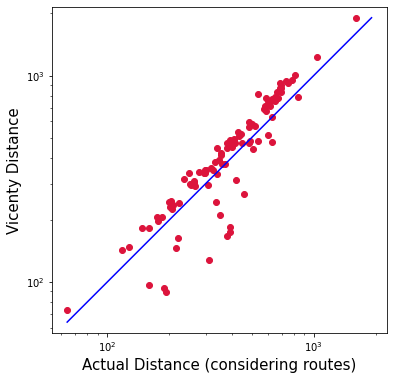

In [42]:
plt.figure(figsize=(6,6))
plt.scatter(df_test['distance_with_stations'], df_test['gis_distance'], c='crimson')
plt.yscale('log')
plt.xscale('log')

p1 = max(max(df_test['distance_with_stations']), max(df_test['gis_distance']))
p2 = min(min(df_test['distance_with_stations']), min(df_test['gis_distance']))
plt.plot([p1, p2], [p1, p2], 'b-')

plt.xlabel('Actual Distance (considering routes)', fontsize=15)
plt.ylabel('Vicenty Distance', fontsize=15)
plt.axis('equal')
plt.show()

*Considering the above plot, we can say that considering only the vicenty distance will not bias our analysis since the log representation of this distance with the actual one is quite linear*

## 3. Analysis

In [ ]:
# In order to analyze the duration, distance and price based on the transport type (carpooling, bus, train)
#we add a column containing the transport_type and a column containing the provider name 
def get_transport_type(id, df_providers):
  return(df_providers[df_providers['id']==id]['transport_type'].values[0],
         df_providers[df_providers['id']==id]['fullname'].values[0])

df_ticket_distance['transport_type'], df_ticket_distance['provider'] = zip(*df_ticket_distance.apply(lambda x: get_transport_type(x.company, df_providers), axis=1))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
# Through the function bellow, we perform a group by origin, destination and transport type in order to determine then
# the min/mean/max of duration and price of each trajectory based on the transport type

def ticket_distance_analysis(df):
  df_g = df.groupby(['o_city','d_city','transport_type'])

  duree_moyenne = df_g['duree'].mean().to_frame(name = 'duree_moyenne').reset_index()
  duree_max = df_g['duree'].max().to_frame(name = 'duree_maximale').reset_index()
  duree_min = df_g['duree'].min().to_frame(name = 'duree_minimale').reset_index()

  mean_price = df_g['price_in_cents'].mean().to_frame(name = 'mean_price').reset_index()
  max_price = df_g['price_in_cents'].max().to_frame(name = 'max_price').reset_index()
  min_price = df_g['price_in_cents'].min().to_frame(name = 'min_price').reset_index()

  df = pd.concat ([duree_min, duree_moyenne, duree_max, min_price, mean_price,max_price], axis=1).T.drop_duplicates().T
  return df

In [ ]:
df_ticket_distance_analysis = ticket_distance_analysis(df_ticket_distance)
df_ticket_distance_analysis.head()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
0,5,23,train,533,618.8,954,18600,20320,22000
1,6,227,train,744,822.5,901,9860,11755,13650
2,6,504,bus,465,564.526,740,2000,3104.21,8920
3,6,504,carpooling,360,395,430,3950,4050,4150
4,6,504,train,336,373.714,406,4950,6585.71,8400


In [ ]:
# Here we add another column called distance_state 

ranges   = {(0,200):'faible', (201,800):'moyenne', (801,2000):'grande'}
valueMap = defaultdict(lambda:'très grande')

for r,letter in ranges.items(): 
  valueMap.update({ v:letter for v in range(*r) })

df_ticket_distance['distance_state'] = df_ticket_distance['distance_with_stations'].apply(lambda x: valueMap[round(x)])
df_ticket_distance.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,id,o_city,d_city,company,duree,vicenty_distance,middle_stations,distance_with_stations,price_in_cents,transport_type,provider,distance_state
0,6795025,611,542,8385,370.0,503.136831,0,503.136831,4550,carpooling,Blablacar,moyenne
1,6795026,611,542,9,1070.0,503.136831,"{149,418}",504.259490,1450,bus,Ouibus,moyenne
2,6795027,611,542,8377,1917.0,503.136831,"{798,798,6794,6246}",755.866163,7400,train,Intercités,moyenne
3,6795028,611,542,8377,1295.0,503.136831,"{798,798,6794,6246}",755.866163,13500,train,Intercités,moyenne
4,6795029,611,542,8381,1306.0,503.136831,"{5983,5983}",630.761929,7710,train,Intercités de Nuit,moyenne


In [ ]:
# min/mean/max of duration and price analysis based on the distance state
df_faible_distance = ticket_distance_analysis(df_ticket_distance[df_ticket_distance['distance_state']=='faible'])
df_moyenne_distance = ticket_distance_analysis(df_ticket_distance[df_ticket_distance['distance_state']=='moyenne'])
df_grande_distance = ticket_distance_analysis(df_ticket_distance[df_ticket_distance['distance_state']=='grande'])
df_tgrande_distance = ticket_distance_analysis(df_ticket_distance[df_ticket_distance['distance_state']=='très grande'])


In [ ]:
df_faible_distance.head()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
0,6,845,bus,251,251,251,2420,2420,2420
1,6,845,carpooling,60,78.191,150,700,848.995,1100
2,11,580,bus,209,209,209,3340,3340,3340
3,11,580,carpooling,100,130,190,1100,1387.5,1700
4,11,580,train,215,274.643,661,1400,3020.71,4600


In [ ]:
df_faible_distance.describe()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
count,483,483,483,483.0,483.0,483.0,483,483.0,483
unique,150,150,3,158.0,385.0,215.0,126,377.0,167
top,628,628,carpooling,120.0,180.0,150.0,1200,1550.0,1800
freq,40,39,269,32.0,10.0,22.0,40,8.0,28


In [ ]:
df_moyenne_distance.describe()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
count,1980,1980,1980,1980.0,1980.0,1980.0,1980,1980.0,1980
unique,256,263,3,536.0,1515.0,787.0,460,1589.0,625
top,628,628,bus,330.0,450.0,450.0,2400,2400.0,2400
freq,297,220,763,30.0,12.0,25.0,65,14.0,39


In [ ]:
df_grande_distance.describe()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
count,366,366,366,366.0,366.0,366.0,366,366.0,366
unique,129,127,3,267.0,344.0,300.0,244,344.0,272
top,628,504,bus,710.0,710.0,770.0,3800,7300.0,5490
freq,41,15,202,5.0,3.0,5.0,9,3.0,6


In [ ]:
df_tgrande_distance.describe()

,o_city,d_city,transport_type,duree_minimale,duree_moyenne,duree_maximale,min_price,mean_price,max_price
count,19,19,19,19.0,19.0,19.0,19,19.0,19
unique,16,17,2,19.0,19.0,19.0,19,19.0,19
top,628,628,bus,1340.0,126.4,895.0,7390,9695.0,22030
freq,2,2,10,1.0,1.0,1.0,1,1.0,1


# III. Data Visualization

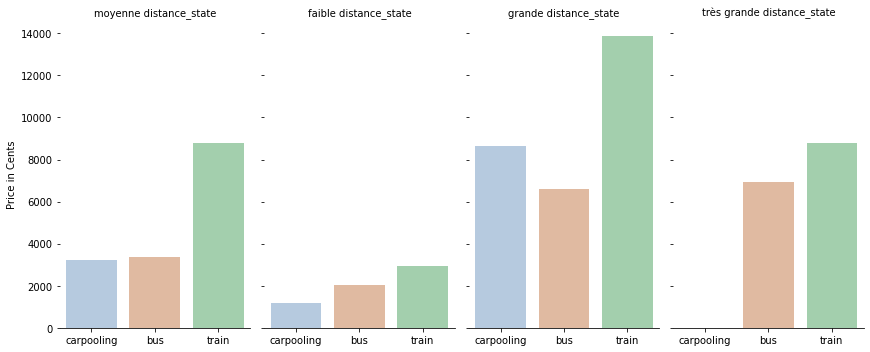

In [ ]:
g = sns.catplot(x="transport_type", y="price_in_cents", col="distance_state",
                data=df_ticket_distance, saturation=.5,
                kind="bar", ci=None, aspect=.6, palette='pastel')
(g.set_axis_labels("", "Price in Cents")
  .set_titles("{col_name} {col_var}")
  .despine(left=True))  

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3747: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


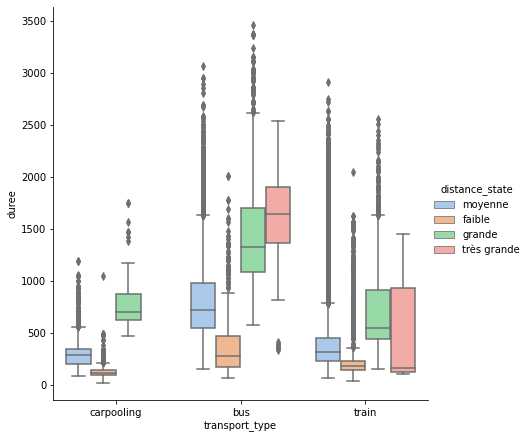

In [ ]:
sns.catplot(x="transport_type", y="duree", kind="box", data=df_ticket_distance[df_ticket_distance['duree']<4000],
            palette='pastel', hue='distance_state', size=6)


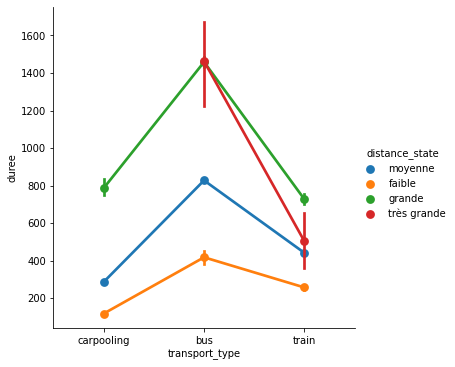

In [ ]:
sns.catplot(x="transport_type", y="duree", hue='distance_state', kind="point", data=df_ticket_distance[df_ticket_distance['duree']<4000])


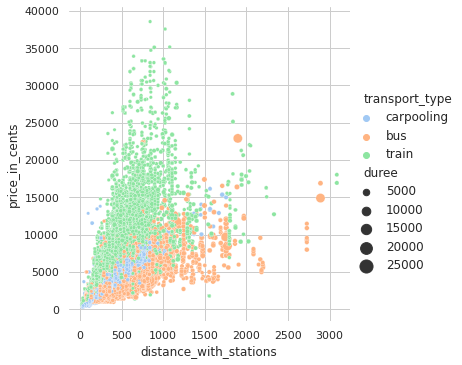

In [ ]:
sns.set_theme(style="whitegrid")
g = sns.relplot(
    data=df_ticket_distance,
    x="distance_with_stations", y="price_in_cents",
    hue="transport_type", size="duree",
    palette='pastel', sizes=(10, 200),
)
g.ax.xaxis.grid(True, "minor", linewidth=.5)
g.ax.yaxis.grid(True, "minor", linewidth=.5)
g.despine(left=True, bottom=True)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn

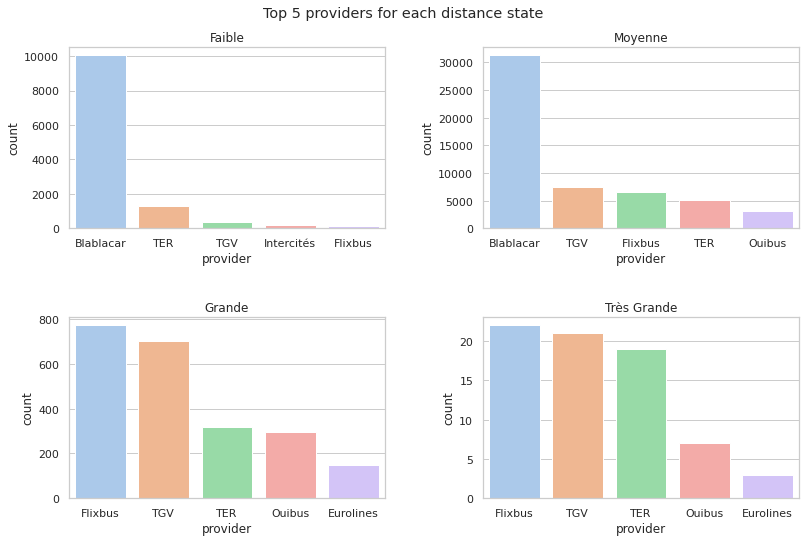

In [ ]:
df1 = df_ticket_distance[df_ticket_distance['distance_state']=='faible']
df2 = df_ticket_distance[df_ticket_distance['distance_state']=='moyenne']
df3 = df_ticket_distance[df_ticket_distance['distance_state']=='grande']
df4 = df_ticket_distance[df_ticket_distance['distance_state']=='très grande']

fig, ax =plt.subplots(2,2, figsize=(12, 8))

ax[0][0].set_title('Faible')
ax[0][1].set_title('Moyenne')
ax[1][0].set_title('Grande')
ax[1][1].set_title('Très Grande')

fig.suptitle('Top 5 providers for each distance state')

sns.countplot(df1['provider'], order=df1.value_counts('provider').iloc[:5].index, ax=ax[0][0], palette='pastel')
sns.countplot(df2['provider'], order=df2.value_counts('provider').iloc[:5].index, ax=ax[0][1], palette='pastel')
sns.countplot(df3['provider'], order=df3.value_counts('provider').iloc[:5].index, ax=ax[1][0], palette='pastel')
sns.countplot(df4['provider'], order=df4.value_counts('provider').iloc[:5].index, ax=ax[1][1], palette='pastel')

fig.tight_layout(pad=3.0)

fig.show()

In [ ]:
def get_city_name(id_o, id_d, df_cities):
  return(df_cities[df_cities['id']==id_o]['unique_name'].values[0],
         df_cities[df_cities['id']==id_d]['unique_name'].values[0])
  
df_analyse_distance['o_city_name'], df_analyse_distance['d_city_name'] = zip(*df_analyse_distance.apply(lambda x: get_city_name(x.o_city, x.d_city, df_cities), axis=1))

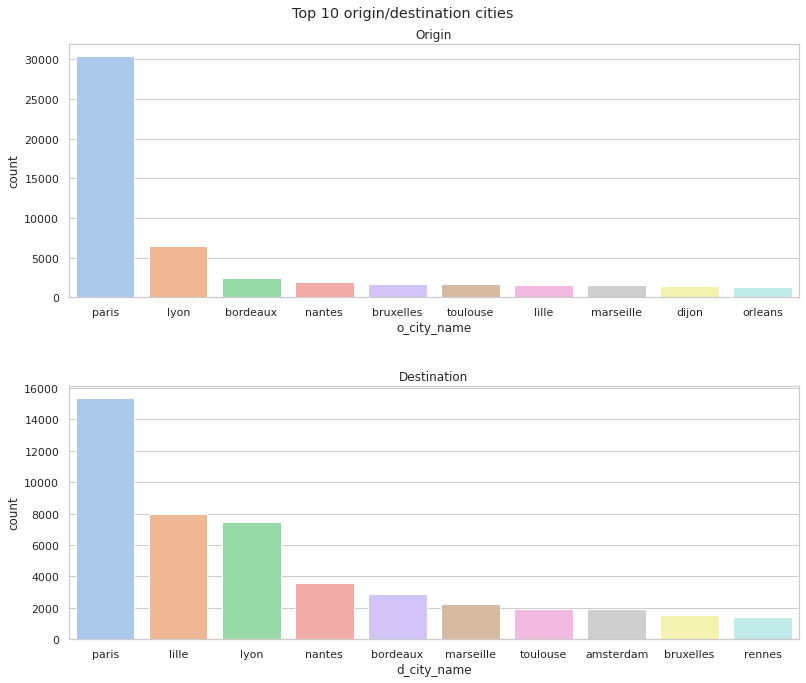

In [ ]:
fig, ax =plt.subplots(2,1, figsize=(12, 10))

ax[0].set_title('Origin')
ax[1].set_title('Destination')

fig.suptitle('Top 10 origin/destination cities')

sns.countplot(x=df_analyse_distance['o_city_name'], order=df_analyse_distance.value_counts('o_city_name').iloc[:10].index, ax=ax[0], palette='pastel')
sns.countplot(x=df_analyse_distance['d_city_name'], order=df_analyse_distance.value_counts('d_city_name').iloc[:10].index, ax=ax[1], palette='pastel')

fig.tight_layout(pad=3.0)

fig.show()

# IV. Locations  Map

In [ ]:
map = folium.Map(location=[df_analyse_distance[:5000].o_lat.mean(), df_analyse_distance[:5000].o_lon.mean()],zoom_start=8, control_scale=True)

for index, location_info in df_analyse_distance[:5000].iterrows():
    folium.Marker([location_info.o_lat, location_info.o_lon],popup=location_info.o_city_name, icon=folium.Icon(color='blue')).add_to(map)
    folium.Marker([location_info.d_lat, location_info.d_lon],popup=location_info.d_city_name, icon=folium.Icon(color='green')).add_to(map)

map

In [ ]:
map_stations = folium.Map(location=[df_stations[:5000].latitude.mean(), df_stations[:5000].longitude.mean()],zoom_start=8, control_scale=True)

for index, location_info in df_stations[:5000].iterrows():
    folium.Marker([location_info.latitude, location_info.longitude],popup=location_info.unique_name, icon=folium.Icon(color='purple')).add_to(map_stations)

map_stations